<a href="https://colab.research.google.com/github/ogeesan/ACAN-2022-Imaging-Workshop/blob/main/ACAN_2022_Analysing_your_data_workbook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Introduction
In this workshop/notebook hybrid thing we're going to play with some data. Some of y'all don't know how to code so I've constructed this notebook in a way that allows anyone to interact with the data. Maybe some of you with programming experience would be interested in loading in the data you've acquired during the course.

There's two halves.

In the first half we've got some `suite2p` data, where you can look at traces. In the second half we've got an example data set that Rei's put together to see how analysis might look.

## Prepare environments
Some sample data exists in the Github Repository and since we're in a Colab notebook we'll clone (copy) that into the colab environment and move ourselves in. If for some reason that doesn't work then we'll be manually uploading the same files into your Colab environment via USB.

In [ ]:
try:
    from google.colab import drive
    IN_COLAB=True
    !git clone https://github.com/ogeesan/ACAN-2022-Imaging-Workshop.git
    %cd ACAN-2022-Imaging-Workshop
except ModuleNotFoundError:
    IN_COLAB=False


if IN_COLAB:
    print("We're running Colab")
    

Cloning into 'ACAN-2022-Imaging-Workshop'...
remote: Enumerating objects: 19, done.
remote: Counting objects: 100% (9/9), done.
remote: Compressing objects: 100% (8/8), done.
remote: Total 19 (delta 0), reused 9 (delta 0), pack-reused 10
Unpacking objects: 100% (19/19), done.
Checking out files: 100% (10/10), done.
/content/ACAN-2022-Imaging-Workshop/ACAN-2022-Imaging-Workshop
We're running Colab


## Python environment

In [ ]:
#@title Import packages for data exploration demo
from pathlib import Path

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
import tifffile

# Loading data
Data has been processed with [suite2p](https://github.com/MouseLand/suite2p). We'll load in their files and if you wish to dig deeper then you can you can consult [the suite2p output file documentation](https://suite2p.readthedocs.io/en/latest/outputs.html).

In [ ]:
#@title Load fluorescence data
datafolder = Path('suite2p/plane0')
rawdata = np.load(datafolder.joinpath('F.npy'))
ops = np.load(datafolder.joinpath('ops.npy'), allow_pickle=True).item()  # dictionary of options
stat = np.load(datafolder.joinpath('stat.npy'), allow_pickle=True)  # array of dicts  about each ROI
iscell = np.load(datafolder.joinpath('iscell.npy'))  # n_rois x 2 array of iscell and classifer confidence

cellbool = iscell[:, 0].astype(bool)
halfframes = int(rawdata.shape[1]/2)

## Viewing data
Let's take a look at the data. First, check out the mean of the entire video with ROIs overlaid.

In total we've got 

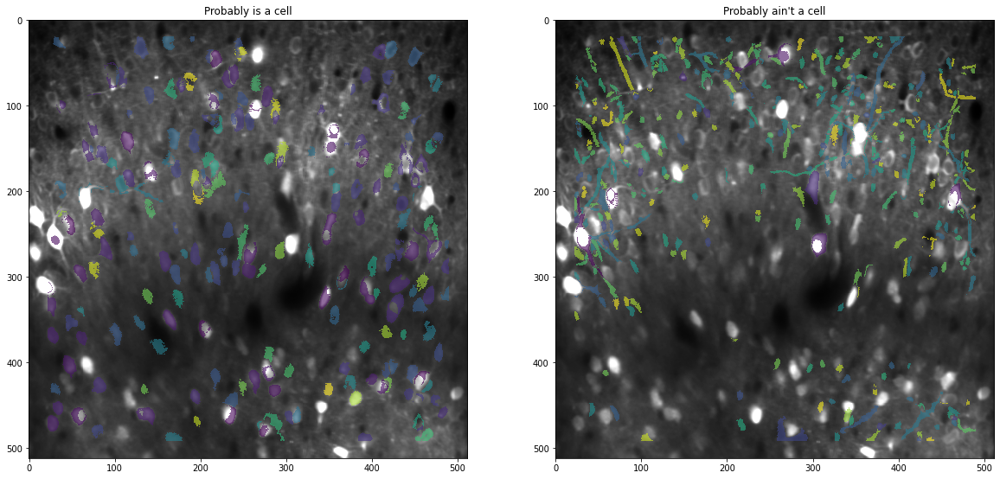

In [ ]:
#@title Plot the field of view and the ROIs
refimg = ops['meanImg']  # Mean of the video

fig, axs = plt.subplots(1,2, figsize=(20,10))

plt.subplot(axs[0])

roiimg = np.zeros((ops['Ly'], ops['Lx']))
for n in range(0,len(stat)):
    if iscell[n,0] == 0:  # first column in iscell is 1/0
        continue
    ypix = stat[n]['ypix'][~stat[n]['overlap']]
    xpix = stat[n]['xpix'][~stat[n]['overlap']]
    roiimg[ypix,xpix] = n+1
roiimg = np.ma.masked_where(roiimg == 0, roiimg)  # Make the zero values into nothin'

plt.imshow(refimg, cmap='gray',vmax=np.percentile(refimg,99), interpolation='none')
plt.imshow(roiimg, alpha=0.6, interpolation='none')
plt.title("Probably is a cell")

# Repeat the process for above, but for ROIs that probably aren't cells
plt.subplot(axs[1])
roiimg = np.zeros((ops['Ly'], ops['Lx']))
for n in range(0,len(stat)):
    if iscell[n,0] == 1:
        continue
    ypix = stat[n]['ypix'][~stat[n]['overlap']]
    xpix = stat[n]['xpix'][~stat[n]['overlap']]
    roiimg[ypix,xpix] = n+1
roiimg = np.ma.masked_where(roiimg == 0, roiimg)

plt.imshow(refimg, cmap='gray',vmax=np.percentile(refimg,99), interpolation='none')
plt.imshow(roiimg, alpha=0.6, interpolation='none')
plt.title("Probably ain't a cell")

plt.show()

## Calculating DFF
Here I'm just taking the median value of each trace. I don't recommend it!

In [ ]:
data = np.zeros(rawdata.shape)
for roi in range(rawdata.shape[0]):
    rawtrace = rawdata[roi]

    f0 = np.median(rawtrace)

    data[roi] = (rawtrace - f0) / f0

Text(0.5, 1.0, 'Heatmap of a (552, 38484) matrix of fluorescence data')

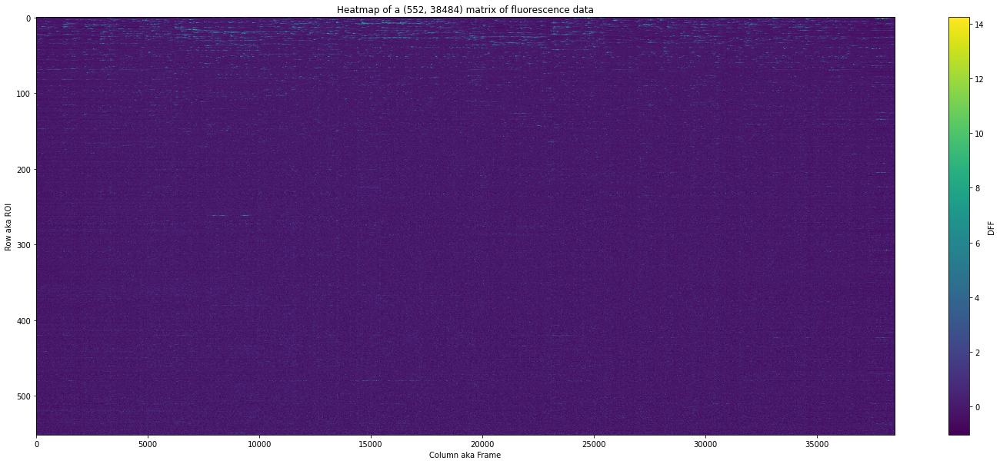

In [ ]:
#@title View matrix of all data
fig = plt.figure(figsize=(25, 10))
plt.imshow(data,
           aspect='auto',
           interpolation='none')
plt.xlabel('Column aka Frame')
plt.ylabel('Row aka ROI')
plt.colorbar(label='DFF')
plt.title(f"Heatmap of a {data.shape} matrix of fluorescence data")
plt.show()

# Exploring Data
Moving around your data in a literal sense is critical for building an understanding of its meaning.

## Plotly controls
Normally I would recommend using an iPython console along with the `%matplotlib` magic to easily create interactive figures using the `matplotlib` package, but since we're operating inside a Google Colab Notebook we can't make use of that. Instead, I'm going to generate some figures using `plotly`, which allows for interactive plots within this notebook. Here are some pointers for interacting with the graphs:

In the top right hand of the following plots there are buttons for zoom, pan, and home.

- Click and drag to zoom/pan
    - Dragging horizontally/vertically will only change that axis
- Hold shift and click and drag to use the opposite of the zoom/pan tool you've selected
- Double clicking on the figure will return to home view
- Axis can be interacted with
    - Click and drag on numbers to pan that axis
    - Click and drag from the corner to change the axis limits (zoom)

Personally I prefer using the pan tool and then holding shift if I want to zoom.

## Exploring whole data
To plot this interactively in the notebook I'm using the `plotly` package, which isn't too happy about large data sets.

In [ ]:
#@title Plot traces{ run: "auto" }
plot_type = "line" #@param ["line", "heatmap"]
data_type = "dff_normalised" #@param ["dff", "dff_normalised", "rawfluorescence"]
#@markdown `yseparation` is only active when using 'line'
yseparation = 1 #@param {type:"slider", min:0, max:50, step:1}
n_rois_show = 30 #@param {type:"integer"}
rois = np.arange(n_rois_show) 

# Type of data to be plotted
if data_type == 'rawfluorescence':
    plotdata = np.copy(rawdata)
else:
    plotdata = np.copy(data)

plotdata = plotdata[rois]  # Plot half of the trace, and only every second frame


# Prepare data
for roi in range(plotdata.shape[0]):
    if data_type == 'dff_normalised':
        plotdata[roi] = plotdata[roi] / plotdata[roi].max()

    # If it's a line plot we need to add an offset to our data so it doesn't all overlap
    if plot_type == 'line':
        plotdata[roi] = plotdata[roi] + yseparation*roi

        
# Plot data
if plot_type == 'heatmap':
    fig = px.imshow(plotdata,
                    aspect='auto',
                    labels={'x': 'Frame', 
                            'y':'ROI', 
                            'color': 'F' if data_type == 'raw' else'DFF'})
elif plot_type == 'line':
    fig = px.line(plotdata.T,
                labels={'index': 'Frame', 
                        'value': 'Norm DFF', 
                        'variable': 'ROI'},
                  )
    
    for x in range(len(rois)):
        fig.data[x].name = f"{rois[x]}"
        fig.data[x].hovertemplate = f'ROI={rois[x]}<br>Frame=%{{x}}<br>iscell = {cellbool[x]}'

fig.show()

In [ ]:
#@title View subset { run: "auto", form-width: "30%" }
#@markdown Enter a `list` of integers for each ROI you want to see

rois = [0, 1, 7] #@param {type:"raw"}
#@markdown Use raw fluorescence (average from video) instead of DFF
useraw = False #@param {type:"boolean"}

fig = px.line(rawdata[rois].T if useraw else data[rois].T,
                labels={'value': 'Raw F' if useraw else 'DFF', 
                        'index': 'Frame',
                        'variable': 'ROI'},
                )

# Make the line names reflect the ROI number
for x in range(len(rois)):
    fig.data[x].name = f"{rois[x]}"
    fig.data[x].hovertemplate = f'ROI={rois[x]}<br>Frame=%{{x}}<br>DFF=%{{y}}<extra></extra>'

fig.update_layout(height=800)
fig.show()

In [ ]:
#@title View x-y offsets of the rigid alignment
offsets = {'yoffset': ops['yoff'],
           'xoffset': ops['xoff']}
offsets = pd.DataFrame(offsets)
offsets = offsets.loc[:rawdata.shape[1],:]  # Apparently the data got fed into suite2p twice so just take half

fig = px.line(offsets,
              labels={'index':'Frame',
                      'value': 'Offset in pixels'})
fig.show()

## Questions to probe
Sometimes exploring data is enough to work something out. Here are some questions that you can approach by using the subset explorer and/or the whole data explorer. Have a play around with some of these, and we'll go through together what might be happening.

- Find an ROI where `iscell = False` but its trace looks good. Why is this?
- Find an ROIs that "look dodgy". What's up with them, and how might you account for them?
- Is there anything odd about the alignment, and if there is is there evidence of this in the fluorescence traces?

- An example of weird/wrong ROIs
- An example of differences in noise
- An example of contamination of signal
- Basically any artefact example

# Analysis of some sample data Rei scrounged
In this section we're going to tinker with some analysis and get you thinking about how one might think about neural activity.
- Quantify stimulus-responsiveness

Analysis is a rabbit hole. The goal in this section is to show you how analysis can be driven by visualisation.

In [ ]:
#@title Import Rei's example data
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.decomposition import PCA

examplefolder = Path('ReisExamples')
deltaF = np.load(examplefolder.joinpath('deltaF.npy'),allow_pickle=True).item() #dictionary with both deltaF and behavior stored
events_dict = np.load(examplefolder.joinpath('events_dict.npy'),allow_pickle=True).item() #dictionary with both events and behavior stored
behavior = pd.read_csv(examplefolder.joinpath('behavior.csv'), index_col=[0])[['response latency', 'validated outcomes']]
hit_inds = behavior.loc[behavior['validated outcomes'] == 'hit'].index.to_list()
CR_inds = behavior.loc[behavior['validated outcomes'] == 'CR'].index.to_list()

d = {(i,j): deltaF[i][j] 
       for i in deltaF.keys() 
       for j in deltaF[i].keys() if j != 'behavior'}
mux = pd.MultiIndex.from_tuples(d.keys())

## Create dataframes of deltaF (without behavior) where each row is a single trial from a single ROI ##
deltaF_all = pd.DataFrame(list(d.values()), index=mux) #All trials
deltaF_hit = deltaF_all.T[hit_inds].T # Hit trials
deltaF_CR = deltaF_all.T[CR_inds].T # Correct rejection trials

## Time alignment
Aligning fluorescence to an event, like a mouse receiving a reward or optogenetic perturbation, is pretty important. This is dependent on your imaging protocol. The two big alternatives are to a) image in a trial-by-trial manner, where the timing of each event is always the same within each trial or b) image continuously and map events onto the imaging later.

`suite2p` is pretty much oriented to deal with continuous data, as `F.npy` contains the fluorescence traces for each ROI in an `nROI x nFramesTotal` format. However, the experiment Rei has done is in the trial by trial format. 


## The experiment
Rei's done an experiment and processed the data:

### The mice
Female C57/BL6 mice were injected with AAV.Syn.GCaMP6f in the forepaw S1 of the left hemisphere at a depth of 300 um from cortical surface.

### The imaging
Awake mice were placed under the Thorlabs 2P scope. Images were acquired at a depth of 174 um at 30Hz acquisition frame rate, and field of view of size 0.768mm x 0.768mm. Each trial was 8 seconds long, and 243 frames were acquired

### The behavior
Water-restricted mice were trained to respond to a vibratory forepaw stimulation of 200Hz/500ms (contralateral to the imaged hemisphere), where their response was reported via licking a lick spout. The trial begins with a broadband auditory cue, after which there is a 3 second "no lick period" where they must withhold their licking in order for the trial to continue. If they correctly respond to the stimulus, then they received a sucrose water reward at a fixed time point 2 seconds after stimulus onset (i.e. these are hit trials). There are also randomly interleaved control trials where there is no stimulus delivered, and therefore no licking response (i.e. these are correct rejection, or CR trials).

In the experiment described at the beginning, we have simultaneously recorded from just under 100 neurons in a specific layer of a cortical region, whilst mice perform a simple behavioral task. In this day and age, this is by no means a big dataset. However, it is still rich enough to gain insights into how these behaviors might be encoded in our brain region of interest. A simple place to start may be to plot the average population activity of certain trial types and temporally align it with behavioral events that occur throughout those trials. Here we will plot the DeltaF/F traces by:


1.   Choosing a trial type of interest
2.   Focusing in on a behavioral event of interest (i.e. stimulus or reward delivery), and look at the "peri-event" activity
3.   Plot population average on each trial, as well as plot each ROIs average across trials






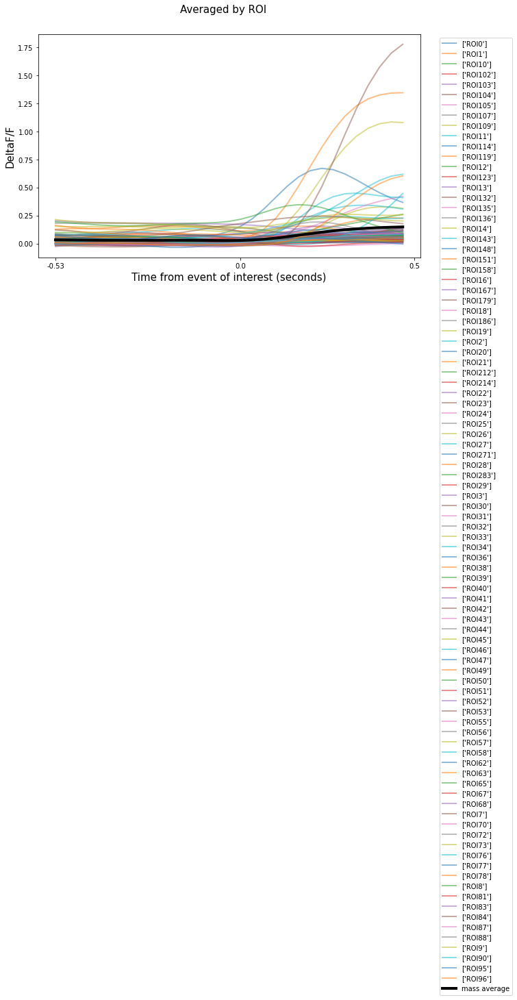

In [ ]:
#@title Plot data of interest in time window of interest
def filter_time_window(df, event, pre, post):
    
    """Filter DeltaF dataframe by aligning to protocol "event" of interest
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    event : str ("trial onset", stim", "lick", or "water")
    pre : int (pre-event time window in seconds)
    post : int (post-event time window in seconds)
    
    
    Returns
    -------
    filtered_df : pandas multiindex dataframe (trials, ROIs)
    """

    if event == 'stim':
        filtered_df = df.T[int(3*30.3)-(int(pre*30.3))-1:int(3*30.3)+(int(post*30.3))].T
    elif event == 'lick':
        filtered_df = pd.DataFrame([]) 
        for index, rows in df.iterrows():
            trial = index[0]
            latency = behavior['response latency'][trial]
            
            if latency != 0:
                filtered_row = rows.to_frame()[int((3+latency)*30.3)-int(pre*30.3)-1:int((3+latency)*30.3)+int(post*30.3)].T
                filtered_row = filtered_row.T.reset_index().T.iloc[1:]
                filtered_df = filtered_df.append(filtered_row)
    elif event == 'water':
        filtered_df = df.T[int(5*30.3)-(int(pre*30.3))-1:int(5*30.3)+(int(post*30.3))].T
    elif event == 'trial onset':
        filtered_df = df.T[0:int(post*30.3)].T
    else:
        raise Exception('No such event "'+event+'"')
    
    columns = range(int(0-pre*30.3)-1, int(0+post*30.3))
    filtered_df.columns = columns
    filtered_df = filtered_df
    
    return filtered_df

def plot_averages(df, average_by):
    
    """Plot overlay of mass-average (across trials and ROIs) with ROI-wise averages or trial-wise averages
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    average_by : str (trial" or "ROI")
    """
        
    if average_by == 'trial':
        avg = df.groupby(level=0, axis=0).mean()
        sem = df.groupby(level=0, axis=0).sem()
    elif average_by == 'ROI':
        avg = df.groupby(level=1, axis=0).mean()
        sem = df.groupby(level=1, axis=0).sem()        
    else:
        raise Exception('Can not average by "'+average_by+'"')
    
    legends = []
    plt.figure(figsize=(10,6))
    for i, (index, rows) in enumerate(avg.iterrows()):
        plt.plot(rows, linewidth=2, alpha=0.5)
        legends.append([str(index)])
    plt.plot(df.mean(axis=0), linewidth=4, color='black')
    plt.legend(legends+['mass average'], loc='upper right', bbox_to_anchor=(0.5, 1, 0.75, 0))
    plt.suptitle('Averaged by '+average_by, fontsize=15)
    start = avg.columns[0]
    end = avg.shape[1]-abs(start)
    plt.xticks([start,0,end], [str(round(x/30.3,2)) for x in [start, 0,end]])
    plt.xlabel('Time from event of interest (seconds)', fontsize=15)
    plt.ylabel('DeltaF/F', fontsize=15)


## Accumulate data and plot it ##
## Select a trial type, behavioral event, and peri-event time window of interest ##
#@markdown trial type
trialtype = deltaF_hit #@param ["deltaF_hit", "deltaF_all", "deltaF_CR"] {type:"raw"}
#behavioural event
event = "stim" #@param ["stim", "lick", "water", "trial onset"]
#pre-event time window in seconds
pre = 0.5 #@param {type:"number"}
#post-event time window in seconds
post = 0.5 #@param {type:"number"}

## Use pre-defined function "filter_time_window" to align your deltaF according to the above parameters ##
deltaF_type_window = filter_time_window(trialtype, event, pre, post)

## Use the predefined function "plot_averages" to plot either ROI-wise or trial-wise averages of deltaF ##
average_by = "ROI" #@param ["ROI", "trial"]
plot_averages(deltaF_type_window, average_by)

You may have noticed that there are some ROIs that have particularly high trial-averaged activity compared to others. You may want to get a feel of what these ROIs trial-by-trial activity looks like. Do they faithfully encode your behavioral event of interest on every trial? Is the signalling highly varied?

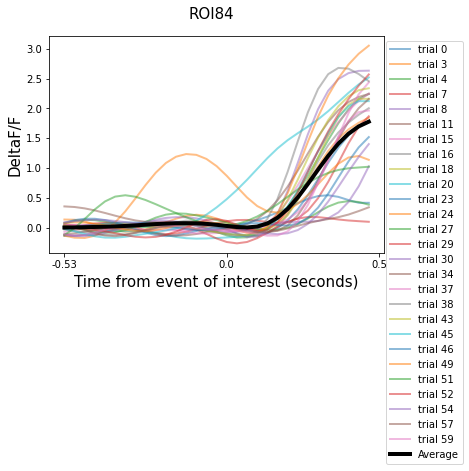

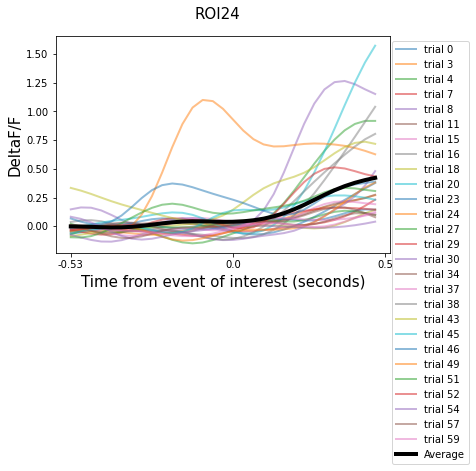

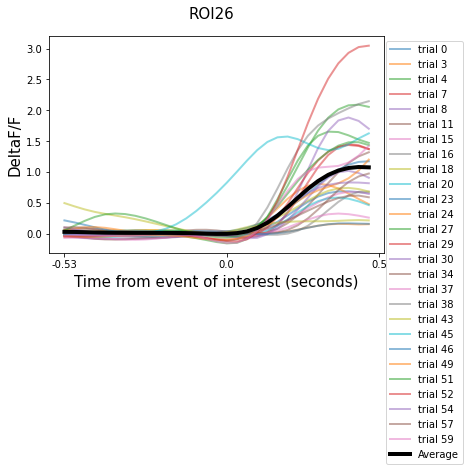

In [ ]:
#@title View a selection of ROIs and how they are behaving in each trial
def plot_single_ROI(df, ROI):
    
    """Plot overlay of averaged and single trial deltaF traces fora  given ROI
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    ROI : str (ROI ID)
    """
    
    groups = df.groupby(level=1)
    ROI_df = groups.get_group(ROI).droplevel(1)
    ROI_df.T.plot(linewidth=2, alpha=0.5)
    ROI_df.mean().T.plot(linewidth=4, color='black')
    plt.suptitle(ROI, fontsize=15)
    start = ROI_df.columns[0]
    end = ROI_df.shape[1]-abs(start)
    plt.xticks([start,0,end], [str(round(x/30.3,2)) for x in [start, 0,end]])
    plt.xlabel('Time from event of interest (seconds)', fontsize=15)
    plt.ylabel('DeltaF/F', fontsize=15)
    plt.legend(['trial '+str(x) for x in list(ROI_df.index)]+['Average'], loc='upper right', bbox_to_anchor=(0.5, 1, 0.75, 0))


#%%
#@markdown Manually select ROIs of interest to view. Entry must be a [valid Python list](https://www.programiz.com/python-programming/list) of strings.
ROIs_to_plot = ['ROI84', 'ROI24', 'ROI26'] #@param

## Plot the trial-by-trial deltaF traces of each ROI of interest on a separate graph ##
for roi in ROIs_to_plot:
    plot_single_ROI(deltaF_type_window, roi)

## Defining selectivity
The above code allows you to examine cell selectivity

One way is through the calculation of a modulation index (MI).

$Modulation Index = \frac{\text{stimulus} - \text{baseline}}{\text{stimulus} + \text{baseline}}$

In this case $\text{stimulus}$ and $\text{baseline}$ are values are the averages of DFF during the one second before (baseline) or after (stimulus) the onset of the forepaw stimulus. For example, if stimulus averages at 3 DFF while baseline averages at 1 for one particular cell, then that will come out to an MI of 2/4. The range of MI is from -1 to 1. An MI of value is when stimulus and baseline are equal, while -1 or 1 would be one of the two being 0.

MI is therefore a relative measure.

Here we will plot the distribution of modulation indexes for all ROIs, with respect to different behavioral events. This may give you an idea of the proprtion of your population that are encoding the different behavioral events.

Another important thing to consider is how you determine the appropriate time window of when you expect your neurons to be active (relative to the behvaioral event). We will also play around with the size of the time window used to calculate the modulation index, and see how that influences our distributions.


Text(0.5, 0, 'Modulation Index')

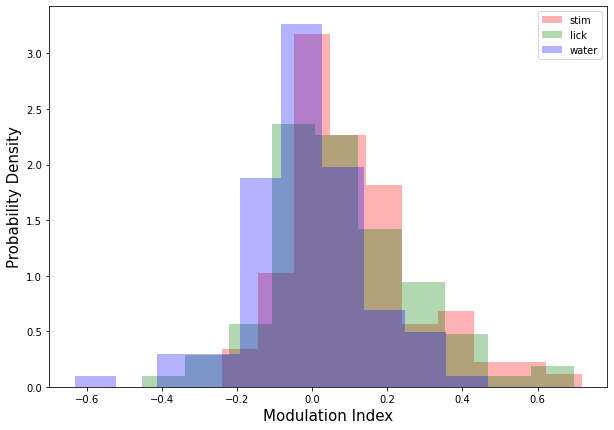

In [ ]:
#@title Modulation Index
def normalize_deltaF(df):
    
    """Perform min-max normalization of deltaF values on ROI-wise, and trial-wise basis (ranges from 0 to 1)
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    
    Returns
    -------
    norm_df : pandas multiindex dataframe (trials, ROIs)
    """
    
    norm_df = df.T.transform(lambda x: (x-x.min())/(x.max()-x.min())).T
    
    return norm_df

#%%

def filter_ROIs(df, event, window, direction='excited', threshold=0.0):
    
    """Filter DeltaF dataframe by retaining ROIs based on modulation index for a certain protocol "event" of interest
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    event : str ("stim", "lick", or "water")
    window : int (post-event time window in seconds)
    direction : str ("excited" or "inhibited")
    threshold : float (quantile cut-off between 0 and 1)
    
    
    Returns
    -------
    filtered_dict : dict {"filtered_df": pandas multiindex dataframe (trials, ROIs) with remaining ROIs
                          "all MI values": pandas series of MI values for all ROIs\
                          "filtered MI values": pandas series of MI values for each remaining ROI}
    """
    
    filtered_dict = {}
    filtered_dict['MI values'] = {}
    if event == 'stim':
        event_deltaF = df.T[int(3*30.3)-1:int(3*30.3)+(int(window*30.3))].T.mean(axis=1)
    elif event == 'lick':
        filtered_df = pd.DataFrame([]) 
        for index, rows in df.iterrows():
            trial = index[0]
            latency = behavior['response latency'][trial]
            
            if latency != 0:
                filtered_row = rows.to_frame()[int((3+latency)*30.3)-1:int((3+latency)*30.3)+int(window*30.3)].T
                filtered_row = filtered_row.T.reset_index().T.iloc[1:]
                filtered_df = filtered_df.append(filtered_row)
        event_deltaF = filtered_df.mean(axis=1)
    elif event == 'water':
        event_deltaF = df.T[int(5*30.3)-1:int(5*30.3)+(int(window*30.3))].T.mean(axis=1)
    elif event == 'trial onset':
        event_deltaF = df.T[0:int(window*30.3)].T.mean(axis=1)        
    else:
        raise Exception('No such event "'+event+'"')
    event_deltaF_avg = event_deltaF.groupby(level=1).mean()
    
    baseline_deltaF = df.T[int((3-window)*30.3)-1:int(3*30.3)].T.mean(axis=1)
    baseline_deltaF_avg = baseline_deltaF.groupby(level=1).mean()
    
    MI_df = (event_deltaF_avg - baseline_deltaF_avg) / (event_deltaF_avg + baseline_deltaF_avg)
    filtered_dict['all MI values'] =  MI_df
    
    
    if direction == 'excited':
        ROIs_to_keep = MI_df[MI_df > 0]
        ROIs_to_keep = ROIs_to_keep[ROIs_to_keep >= ROIs_to_keep.quantile(threshold)]
    elif direction == 'inhibited':
        ROIs_to_keep = MI_df[MI_df < 0]
        ROIs_to_keep = ROIs_to_keep[ROIs_to_keep <= ROIs_to_keep.quantile(threshold)]
    else:
        raise Exception('No such direction "'+direction+'"')    
    
    filtered_dict['MI values'] = ROIs_to_keep
        
    ROI_list = list(ROIs_to_keep.index)
    filtered_df = trialtype.iloc[trialtype.index.get_level_values(1).isin(ROI_list)]
    filtered_dict['filtered_df'] = filtered_df
    
    return filtered_dict

## In order to use the Modulation Index, we first need to normalize our deltaF to range from 0 to 1 ##
deltaF_hit_normalized = normalize_deltaF(deltaF_hit)

#@markdown Select post-event time window
window = 2.5 #@param {type:"slider", min:0, max:3, step:0.1}

legends = []
plt.figure(figsize=(10,7))
for event, color in zip(['stim', 'lick', 'water'], ['red','green','blue']):
    filtered_dict = filter_ROIs(deltaF_hit_normalized, event, window)
    plt.hist(filtered_dict['all MI values'], color=color, alpha=0.3, density=True)
    legends.append(event)
plt.legend(legends)
plt.ylabel('Probability Density', fontsize=15)
plt.xlabel('Modulation Index', fontsize=15)

Now that we've had a brief skim of how we might visualize some of our data, we will combine all of the things up until now and have a play around with a smaller subset of our population of neurons. Specifically, we will:



1.   Choose a trial type
2.   Choose a behavioral event of interest
3.   Choose a time window size
4.   Choose a subset of ROIs based on modulation index (either excited or inhibited by the behavioral event)
5.   We can also adjust the modulation selection criteria (based on quantiles)
6.   Plot either ROI-wise or trial-wise activity



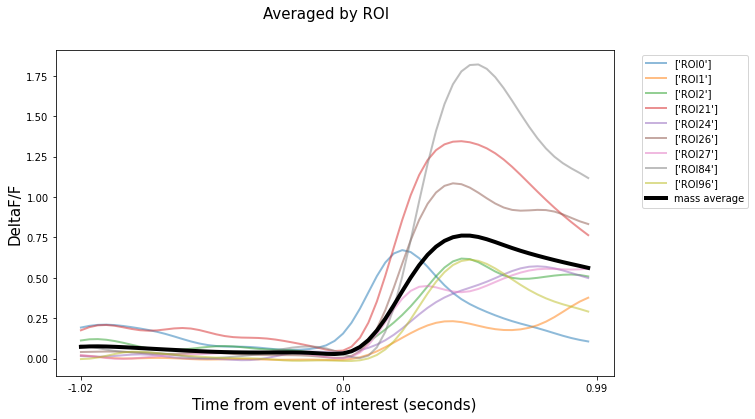

In [ ]:
#@title Now repeat the average plotting process with some more refined ROI selections
#@markdown Choose parameters of ROI selection
trialtype = deltaF_hit #@param ["deltaF_hit", "deltaF_all", "deltaF_CR"] {type:"raw"}
event = "stim" #@param ["stim", "lick", "water", "trial onset"]
window = 0.5 #@param {type:"slider", min:0, max:3, step:0.1}
direction = "excited" #@param ["excited", "inhibited"]
average_by = "ROI" #@param ["ROI", "trial"]
threshold= 0.9 #@param {type:"slider", min:0, max:1, step:0.1}


#@markdown Pre and post only used for plotting purposes (up to 3s)
pre = 1 #@param {type:"number"}
post = 1 #@param {type:"number"}

## Use pre-defined function "filter_time_window" to align your deltaF according to the above parameters ##
deltaF_type_window = filter_time_window(trialtype, event, pre, post)

## Use the predefined function "plot_averages" to plot either ROI-wise or trial-wise averages of deltaF ##

deltaF_type_normalized = normalize_deltaF(trialtype)
MI_filtered = filter_ROIs(deltaF_type_normalized, event, window, direction, threshold)
MI_filtered_df = MI_filtered['filtered_df']
MI_filtered_df_window = filter_time_window(MI_filtered_df, event, pre, post)
plot_averages(MI_filtered_df_window, average_by)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:27: FutureWarning:

In a future version of pandas all arguments of Series.sort_values will be keyword-only



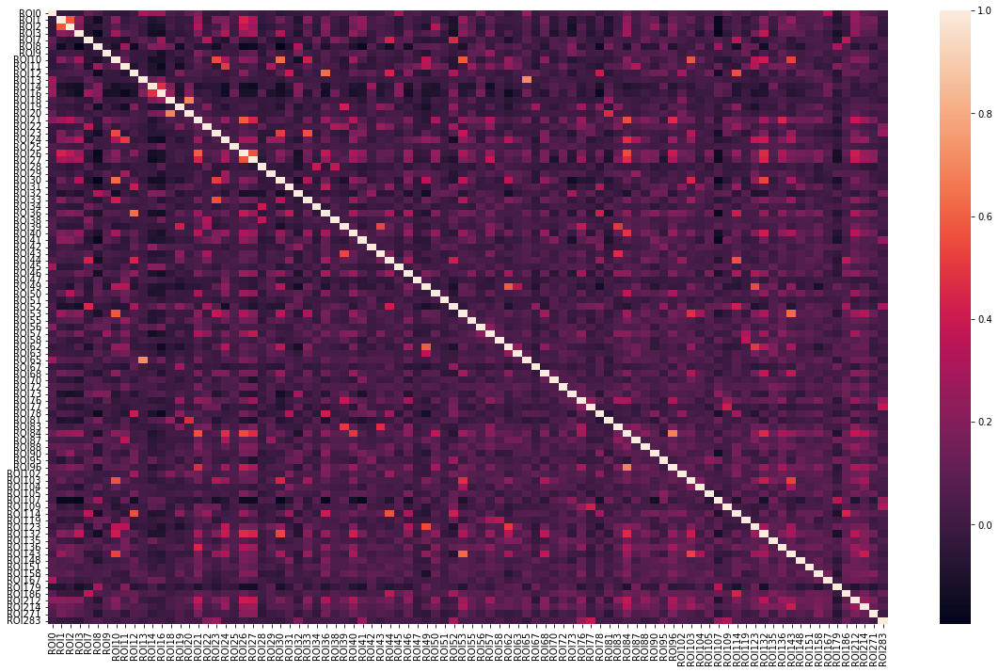

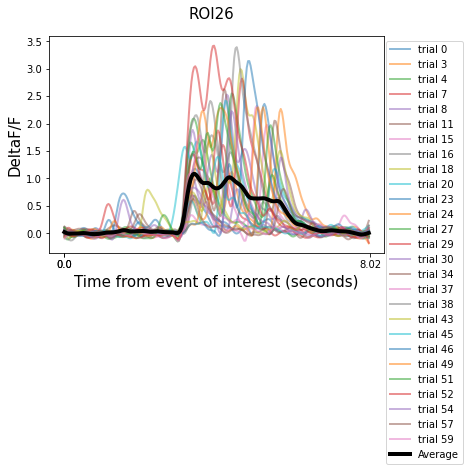

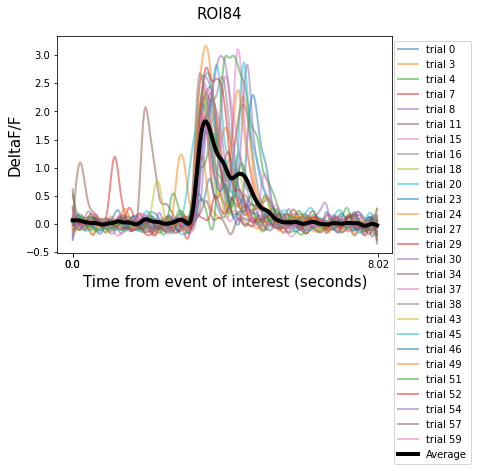

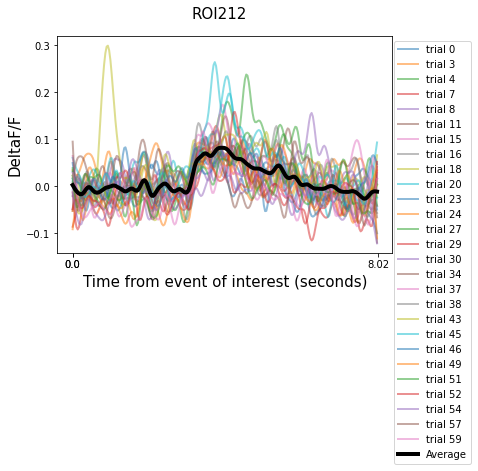

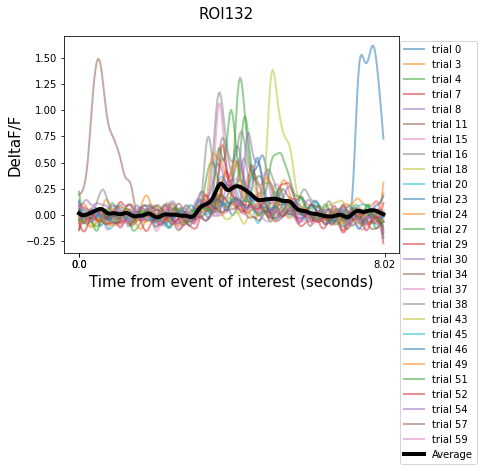

...

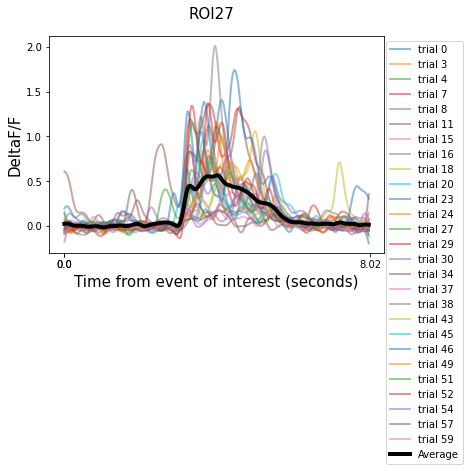

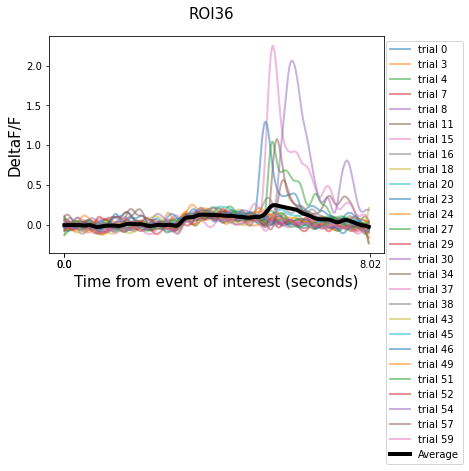

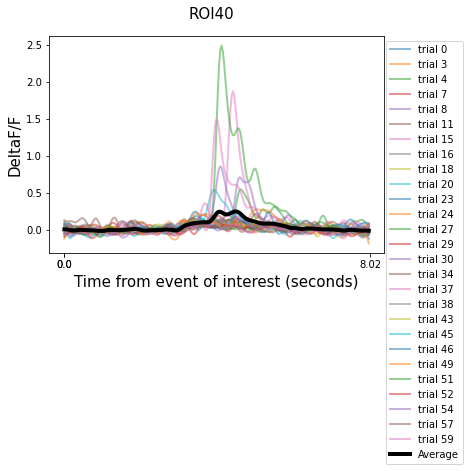

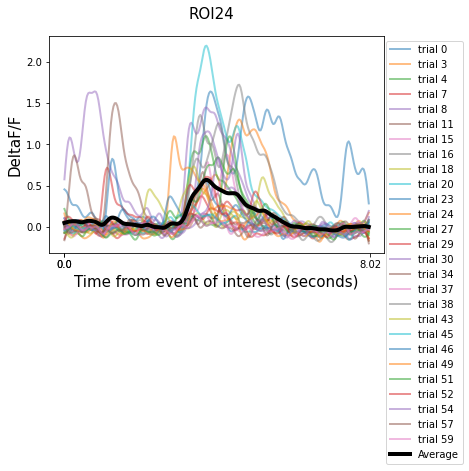

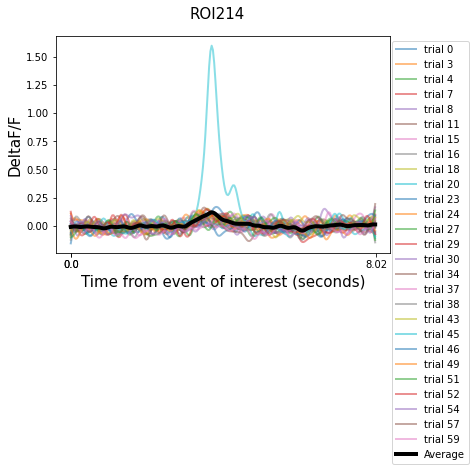

In [ ]:
#@title What about correlated activity between neurons?
#@markdown Here you can look at which neurons are highly correlated with each other, and then dig deeper to see if there is something special about these correlated neurons. Would you want to calculate the correlations only during certain time windows of interest (i.e. during stimulus) or across the entire recording? Maybe some neurons are only correlated during certain behavioral events.
def get_pairwise_correlations(df, nROIs):
    
    """Perform pairwise corelations of deltaF values between ROIs, and select the "most correlated" ROIs
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    nROIs : int (top n most correlated ROIs you want to select)
    
    Returns
    -------
    top_correlated_ROIs : list (of ROI IDs that have the highest average pairwise correlations)
    """
    groups = df.groupby(level=1)

    concat_df = pd.DataFrame([])
    for roi in df.index.get_level_values(1).unique():
        roi_df = groups.get_group(roi).stack().reset_index().T.iloc[-1].to_frame()
        roi_df.columns = [roi]
        roi_df = roi_df.T
        concat_df = concat_df.append(roi_df)
    concat_df = concat_df.astype(float)
    corr_df = concat_df.T.corr()
    mean_ROI_correlations = corr_df.abs().mean()
    top_correlated_ROIs = mean_ROI_correlations.sort_values(0, ascending=False).index[:nROIs].tolist()
    
    plt.figure(figsize=(20,12))
    sns.heatmap(corr_df, xticklabels=corr_df.columns, yticklabels=corr_df.columns)
    
    return top_correlated_ROIs

#%%

## Here we will plot the pairwise correlations between all ROIs (across the entire recording) ##
#@markdown The top n "most correlated" ROIs you want to select (for plotting)
nROIs = 10 #@param {type:"integer"}
top_correlated_ROIs = get_pairwise_correlations(deltaF_all, nROIs)

## Now we will look at what the most correlated ROIs are doing on HIT trials ##
for roi in top_correlated_ROIs:
    plot_single_ROI(deltaF_hit, roi)

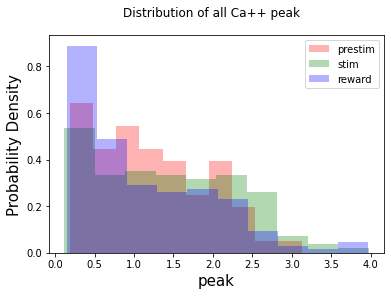

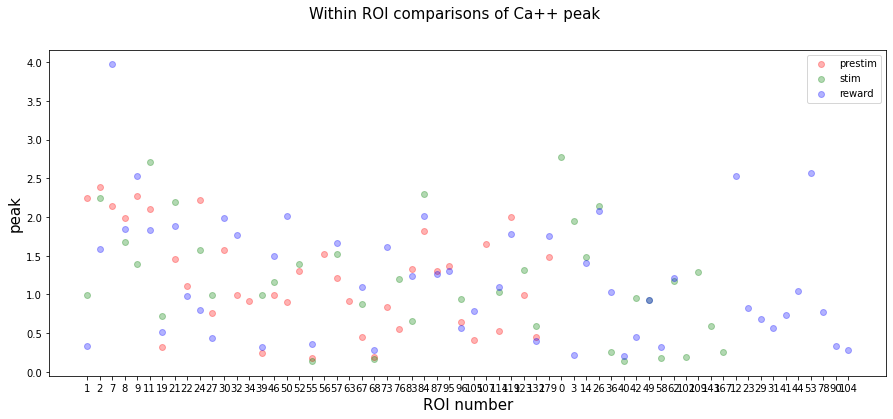

In [ ]:
#@title We can also use event detection algorithms and analyze these events instead of DeltaF/F traces
#@markdown We can focus in on metrics of these events (i.e. peak amplitude, event onset, event frequency, etc.) and compare these metrics across our conditions of interest

def plot_ROI_event_metrics(events_dict, events, trialtype, metric):  
    
    """Plot metric of interest of detected events during your behavioral event/trial type of interest
    
    Parameters
    ----------
    events_dict : dictionary {behavioral event of interest: pandas dataframe (of all the events)}
    events : str (behavioral event of interest)
    trialtype : str (trial type of interest)
    metric : str (event metric of interest)
    """
        
    if metric != 'frequency':
        legends = []
        for event, color in zip(events, ['red', 'green', 'blue']):
            if event == 'reward':
                subtractor = 5
            elif event == 'ITI':
                subtractor = 7
            else:
                subtractor = 3
            event_df = events_dict[event]
            
            if trialtype == 'all':
                type_df = event_df
            else:
                type_df = event_df[event_df.outcome == trialtype]

            type_df['ev_onset'] = type_df['ev_onset'] - subtractor

            plt.hist(type_df[metric], color=color, density=True, alpha=0.3)
            legends.append(event)
        plt.legend(legends)
        plt.xlabel(metric, fontsize=15)
        plt.ylabel('Probability Density', fontsize=15)
        plt.suptitle('Distribution of all Ca++ '+metric)
    elif metric == 'frequency':
        None
    else:
        raise Exception('No such metric '+metric)
    
    plt.figure(figsize=(15,6))
    legends2 = []
    for event, color in zip(events, ['red', 'green', 'blue']):
        if event == 'reward':
            subtractor = 5
        elif event == 'ITI':
            subtractor = 7
        else:
            subtractor = 3
        event_df = events_dict[event]
        
        if trialtype == 'all':
            type_df = event_df
        else:
            type_df = event_df[event_df.outcome == trialtype]
        metric_means = type_df.groupby('ROI').mean()
        groups = type_df.groupby('ROI')
        metric_values = {}
        for ROI in list(deltaF[0].keys())[:-1]:
            try:
                ROI_df = groups.get_group(ROI)
                
                if metric == 'frequency':
                    if trialtype == 'all':
                        metric_value = ROI_df.shape[0] / behavior['validated outcomes'].shape[0]
                    else:
                        metric_value = ROI_df.shape[0] / behavior['validated outcomes'].value_counts()[trialtype]
                elif metric == 'ev_onset':
                    ROI_df['ev_onset'] = ROI_df['ev_onset'] - subtractor
                    metric_value = ROI_df[metric].mean()
                elif metric in ['ev_onset', 'peak', 'ev_duration', 'integral', 'peak_time']:
                    metric_value = ROI_df[metric].mean()
                else:
                    raise Exception('No such metric '+metric)
                metric_values[ROI] = metric_value
            except KeyError:
                if metric == 'frequency':
                    metric_values[ROI] = 0
                elif metric in ['ev_onset', 'peak', 'ev_duration', 'integral', 'peak_time']:
                    None
                else:
                    raise Exception('No such metric '+metric)
        plt.scatter([x.split('ROI')[1] for x in list(metric_values.keys())], metric_values.values(), color=color, alpha=0.3)
        legends2.append(event)
    plt.legend(legends2)
    plt.xlabel('ROI number', fontsize=15)
    plt.ylabel(metric, fontsize=15)
    plt.suptitle('Within ROI comparisons of Ca++ '+metric, fontsize=15)

## Here we will plot metrics of interest of detected events and compare them across behavioral events of interest ##
# behavioral events you want to overlay (i.e. are the detected events different)
events = ["prestim", "stim", "reward", "response", "ITI"]
# trial type you want to focus on ('hit', 'CR', 'all')
trialtype = 'all' #@param ["all", 'hit", "CR"]
# detected event metric you want to look at ('ev_onset', 'frequency', 'peak', 'integral', 'ev_duration', 'peak_time')
metric = 'peak' #@param ['ev_onset', 'frequency', 'peak', 'integral', 'ev_duration', 'peak_time']

plot_ROI_event_metrics(events_dict, events, trialtype, metric)

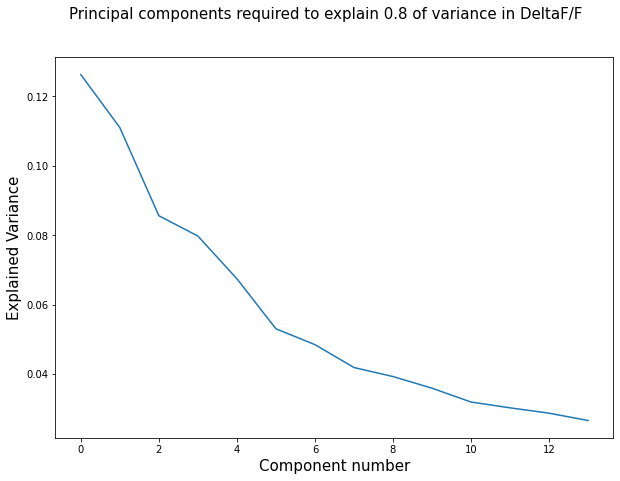

,PC0,PC1,PC2,PC3,PC4,PC5,PC6,PC7,PC8,PC9,PC10,PC11,PC12,PC13
ROI0,-0.091306,-0.018086,0.214052,-0.052164,0.039517,0.123026,0.032807,0.056562,-0.002698,-0.188861,0.141609,-0.082277,0.094649,-0.193116
ROI1,-0.048291,-0.024364,-0.063066,-0.154438,0.213204,-0.024735,-0.074117,0.031026,0.101841,0.129205,-0.034998,0.068973,-0.118581,-0.100111
ROI2,-0.112413,-0.068426,-0.145201,-0.030654,0.063877,-0.015027,0.092357,0.049048,0.224775,-0.051941,-0.218159,-0.154086,0.013455,-0.070744
ROI3,-0.035058,0.077011,-0.135201,0.003540,-0.011360,0.258461,-0.176502,0.039100,0.142431,-0.054453,-0.031750,0.068856,-0.069186,-0.052493
ROI7,0.014928,-0.090730,-0.008159,0.294639,0.135915,0.033813,-0.029659,0.059485,-0.093801,-0.086660,0.012081,0.060472,-0.047322,0.033958
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ROI186,-0.093449,-0.016353,0.112303,0.180940,0.074797,-0.034279,0.053710,0.087646,0.056616,-0.095609,-0.029332,0.216214,0.036123,0.040670
ROI212,-0.185352,0.053338,-0.100310,0.019253,0.041587,0.140150,-0.114453,-0.000711,0.079631,0.110056,0.037272,0.021943,0.132028,0.107960
ROI214,-0.133629,0.063799,0.055219,-0.028127,0.093634,-0.036416,-0.021324,-0.202418,0.006951,0.004189,0.030745,0.020821,0.293798,-0.015864
ROI271,-0.186809,0.085961,0.116828,0.062395,-0.023938,-0.079626,-0.075095,0.060542,-0.092773,-0.007327,0.116765,-0.051066,-0.152620,0.009376


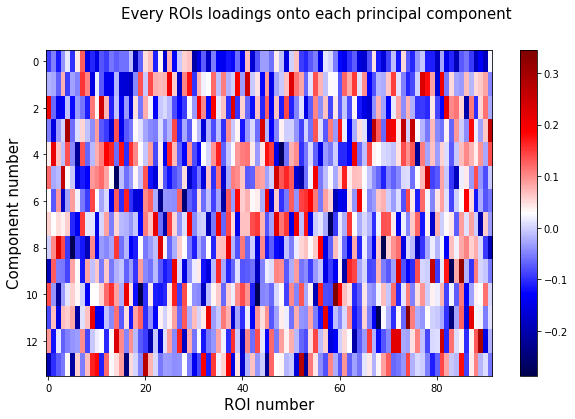

In [ ]:
#@title Using Principal Components Analysis
def pca_plots(df, var_explained):
    
    """Perform PCA on trial-by-trial averages across time windows/trial types of interest and plot the results
    
    Parameters
    ----------
    df : pandas multiindex dataframe (trials, ROIs)
    var_explained : float (fraction of total variance that you want your principal components to explain)
    """
    
    groups = df.groupby(level=0)

    trial_mean_df = pd.DataFrame([])
    for trial in df.index.get_level_values(0).unique():
        trial_df = groups.get_group(trial).mean(axis=1).to_frame().droplevel(0)
        trial_df.columns = [trial]
        trial_df = trial_df.T
        trial_mean_df = trial_mean_df.append(trial_df)
        
    trial_mean_normalized = (trial_mean_df - trial_mean_df.mean()) / trial_mean_df.std()
    pca = PCA(n_components=var_explained)
    pca.fit(trial_mean_normalized)

    # Reformat and view results
    loadings = pd.DataFrame(pca.components_.T,
    columns=['PC%s' % _ for _ in range(pca.n_components_)],
    index=trial_mean_df.columns)

    plt.figure(figsize=(10,7))
    plt.plot(pca.explained_variance_ratio_)
    plt.ylabel('Explained Variance', fontsize=15)
    plt.xlabel('Component number', fontsize=15)
    plt.suptitle('Principal components required to explain '+str(0.8)+' of variance in DeltaF/F', fontsize=15)
    plt.show()

    display(loadings)

    plt.figure(figsize=(10,6))
    plt.imshow(loadings.T, aspect='auto', cmap='seismic')
    plt.colorbar()
    plt.xlabel('ROI number', fontsize=15)
    plt.ylabel('Component number', fontsize=15)
    plt.suptitle('Every ROIs loadings onto each principal component', fontsize=15)

#%%

## First we will choose a time window during a certain trial type that we are interested in ##
trialtype = deltaF_hit #@param ["deltaF_hit", "deltaF_all", "deltaF_CR"] {type:"raw"}
#behavioural event
event = "stim" #@param ["stim", "lick", "water", "trial onset"]
#pre-event time window in seconds
pre = 0.5 #@param {type:"number"}
#post-event time window in seconds
post = 0.5 #@param {type:"number"}


deltaF_type_window = filter_time_window(trialtype, event, pre, post)

## Now we will perform PCA with our desired fraction of explained variance, and plot the results ##
var_explained = 0.8 #@param {type:"slider", min:0, max:1, step:0.05}
pca_plots(deltaF_type_window, var_explained)